In [50]:
from google.colab import drive
import matplotlib.pyplot as plt
import numpy as np
import cv2
import os
%matplotlib inline

In [51]:
drive.mount('/content/drive')
folder_path = '/content/drive/MyDrive/22101326_Md Rakibul Hasan_Lab3/Image'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


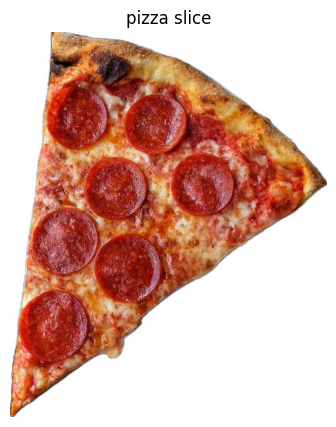

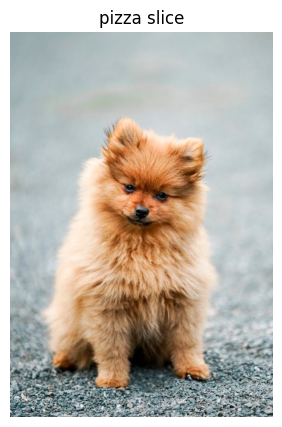

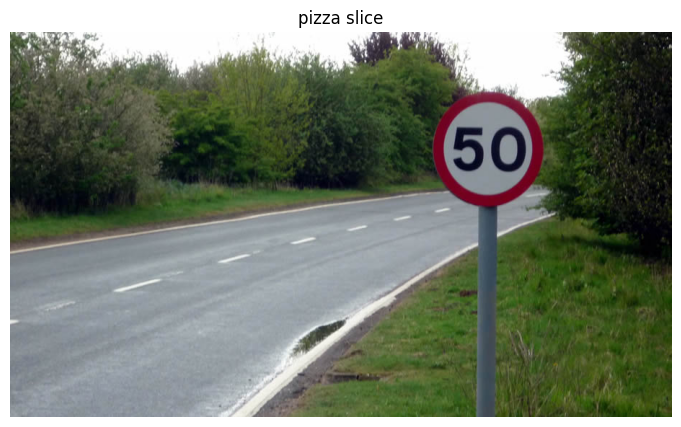

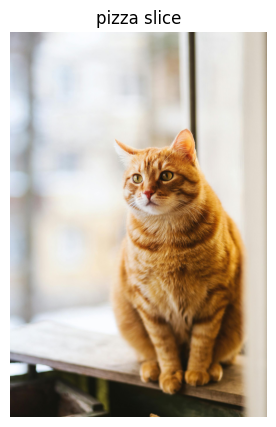

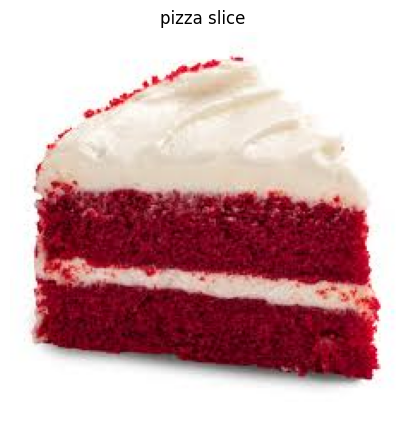

In [81]:
for image in os.listdir(folder_path):
    image_path = os.path.join(folder_path, image)
    img = cv2.imread(image_path,cv2.IMREAD_COLOR_RGB)
    if img is not None:
        plt.figure(figsize=(10, 5))
        plt.imshow(img,cmap='gray')
        plt.axis('off')
        plt.title('pizza slice')
        plt.show()

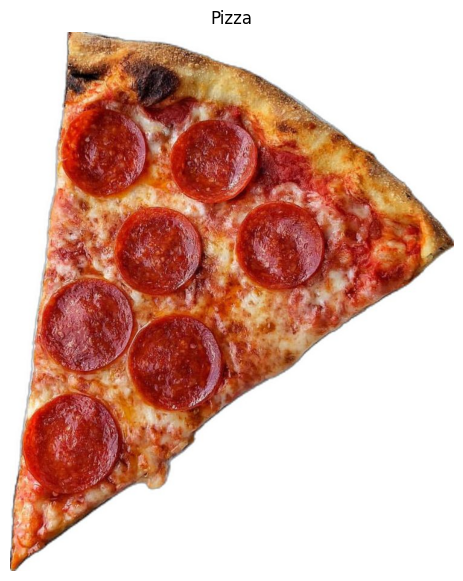

In [110]:
image_path = os.path.join(folder_path, os.listdir(folder_path)[0])
image = cv2.imread(image_path)
image_Copy = np.copy(image)
image_copy = cv2.cvtColor(image_Copy, cv2.COLOR_BGR2RGB)
plt.imshow(image_copy)
plt.title('Pizza')
plt.axis('off')
plt.show()

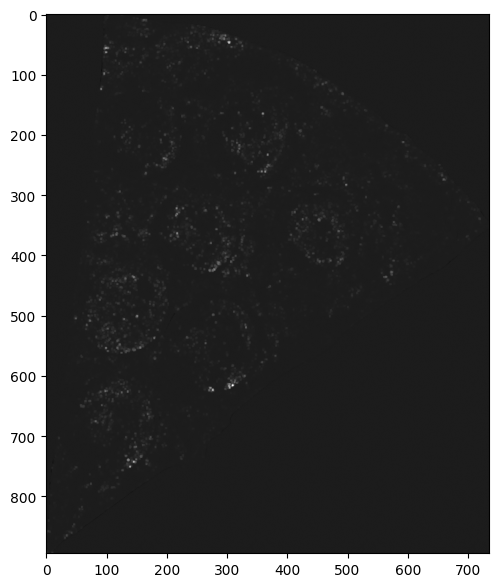

In [111]:
# Convert to grayscale
gray = cv2.cvtColor(image_copy, cv2.COLOR_RGB2GRAY)
gray = np.float32(gray)

# Detect corners
dst = cv2.cornerHarris(gray, 2, 3, 0.05)

# Enhance corner points
dst = cv2.dilate(dst,None)

plt.imshow(dst, cmap='gray')

1.   Corners were detected on most of the pepperoni slices
2.   No, the crust edges are not identified as corners
3.   Cheese textures are detected as corners

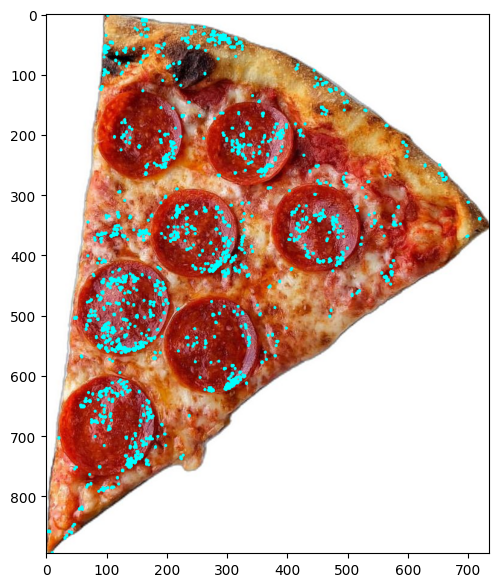

In [112]:
threshold = 0.05*dst.max()

# Create an image copy to draw corners on
corner_image = np.copy(image_copy)

# Iterate through all the corners and draw them on the image (if they pass the threshold)
for j in range(0, dst.shape[0]):
    for i in range(0, dst.shape[1]):
        if(dst[j,i] > threshold):
            # image, center pt, radius, color, thickness
            cv2.circle( corner_image, (i, j), 1, (0,255,255), 1)

plt.imshow(corner_image)

* Does it detect corners on the pepperoni slices?

Ans: No, unless there are irregular edges or burnt spots.

* Are the crust edges identified as corners?

Ans: Mostly no, except for jagged or cracked areas.

* How does the algorithm handle the "cheese texture"?

Ans: Smooth areas are ignored, but bubbles or burnt spots may get weak detections.

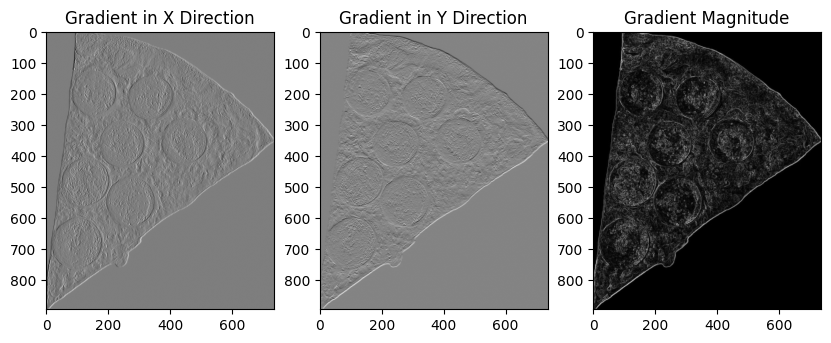

In [113]:
# Read the image and convert to grayscale
gray = cv2.cvtColor(image_Copy, cv2.COLOR_BGR2GRAY)

# Compute gradients using Sobel operator
grad_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)  # Gradient in X direction
grad_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)  # Gradient in Y direction

# Compute gradient magnitude
magnitude = np.sqrt(grad_x**2 + grad_y**2)

# Normalize magnitude for visualization
magnitude = cv2.normalize(magnitude, None, 0, 255, cv2.NORM_MINMAX)

# Display results
plt.figure(figsize=(10, 5))
plt.subplot(1, 3, 1)
plt.title("Gradient in X Direction")
plt.imshow(grad_x, cmap='gray')
plt.subplot(1, 3, 2)
plt.title("Gradient in Y Direction")
plt.imshow(grad_y, cmap='gray')
plt.subplot(1, 3, 3)
plt.title("Gradient Magnitude")
plt.imshow(magnitude, cmap='gray')
plt.show()

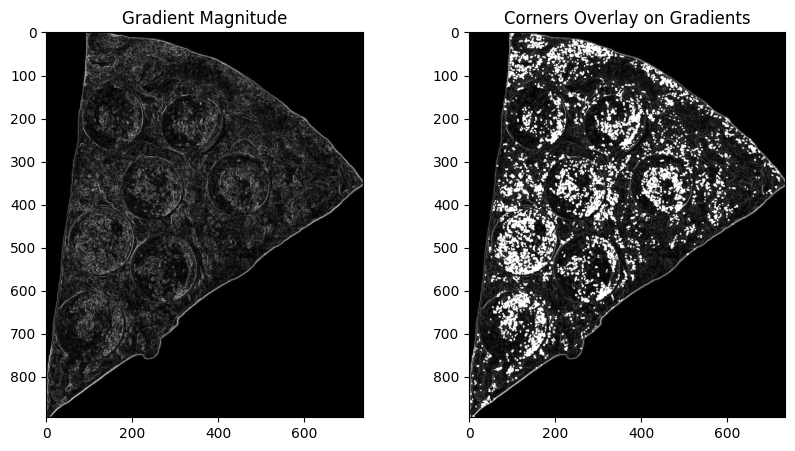

In [114]:
# Detect corners using Harris corner detection
dst = cv2.cornerHarris(np.float32(gray), 2, 3, 0.04)
dst = cv2.dilate(dst, None)

# Threshold to find strong corners
threshold = 0.01 * dst.max()
corners = dst > threshold

# Create a copy of the gradient magnitude to overlay corners
overlay = np.copy(magnitude)
overlay[corners] = 255  # Highlight corners

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Gradient Magnitude")
plt.imshow(magnitude, cmap='gray')
plt.subplot(1, 2, 2)
plt.title("Corners Overlay on Gradients")
plt.imshow(overlay, cmap='gray')
plt.show()


* Does it detect corners on the pepperoni slices?

Ans: No it doesnt show pepperoni slices clearly.

* Are the crust edges identified as corners?

Ans: Yes crust are identified as corners but slightly less intese detection.

* How does the algorithm handle the "cheese texture"?

Ans:It can not detect the cheese texture.

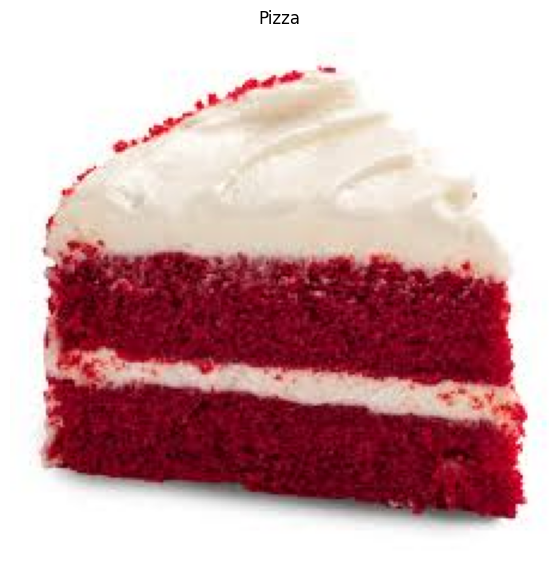

In [96]:
image_path = os.path.join(folder_path, os.listdir(folder_path)[4])
image = cv2.imread(image_path)
image_Copy = np.copy(image)
image_copy = cv2.cvtColor(image_Copy, cv2.COLOR_BGR2RGB)
# plt.imshow(image, cmap='gray')
plt.imshow(image_copy)
plt.title('Pizza')
plt.axis('off')
plt.show()

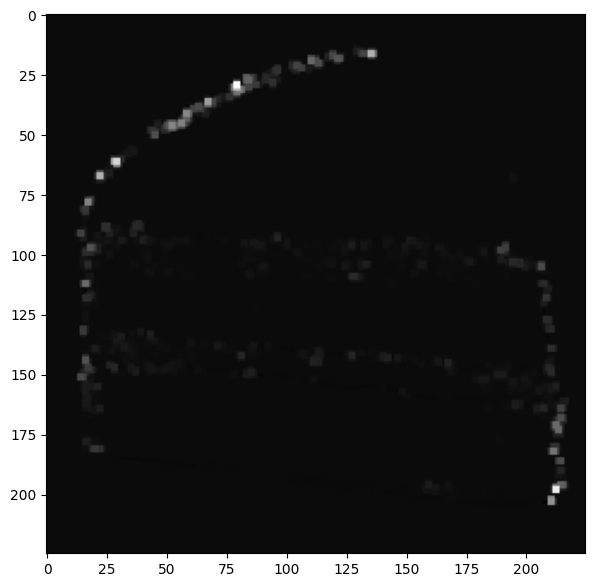

In [97]:
# Convert to grayscale
gray = cv2.cvtColor(image_copy, cv2.COLOR_RGB2GRAY)
gray = np.float32(gray)

# Detect corners
dst = cv2.cornerHarris(gray, 2, 3, 0.04)

# Enhance corner points
dst = cv2.dilate(dst,None)

plt.imshow(dst, cmap='gray')

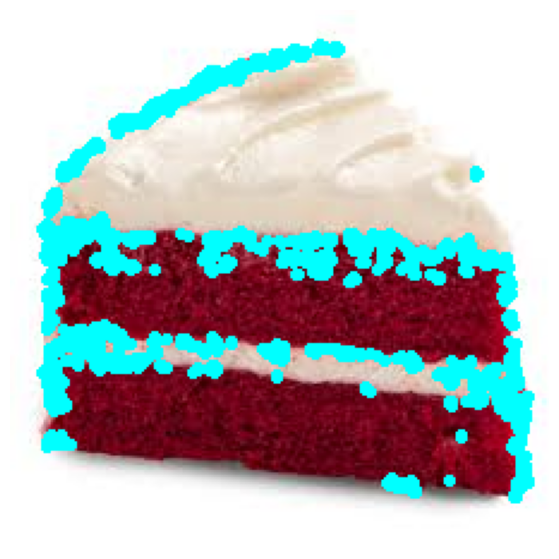

In [105]:
threshold = 0.005*dst.max()

# Create an image copy to draw corners on
corner_image = np.copy(image_copy)

# Iterate through all the corners and draw them on the image (if they pass the threshold)
for j in range(0, dst.shape[0]):
    for i in range(0, dst.shape[1]):
        if(dst[j,i] > threshold):
            # image, center pt, radius, color, thickness
            cv2.circle( corner_image, (i, j), 1, (0,255,255), 1)

plt.imshow(corner_image)
plt.axis('off')
plt.show()

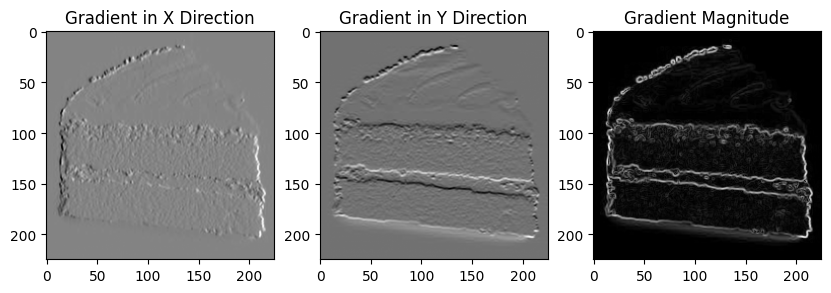

In [106]:
# Read the image and convert to grayscale
gray = cv2.cvtColor(image_Copy, cv2.COLOR_BGR2GRAY)

# Compute gradients using Sobel operator
grad_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)  # Gradient in X direction
grad_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)  # Gradient in Y direction

# Compute gradient magnitude
magnitude = np.sqrt(grad_x**2 + grad_y**2)

# Normalize magnitude for visualization
magnitude = cv2.normalize(magnitude, None, 0, 255, cv2.NORM_MINMAX)

# Display results
plt.figure(figsize=(10, 5))
plt.subplot(1, 3, 1)
plt.title("Gradient in X Direction")
plt.imshow(grad_x, cmap='gray')
plt.subplot(1, 3, 2)
plt.title("Gradient in Y Direction")
plt.imshow(grad_y, cmap='gray')
plt.subplot(1, 3, 3)
plt.title("Gradient Magnitude")
plt.imshow(magnitude, cmap='gray')
plt.show()

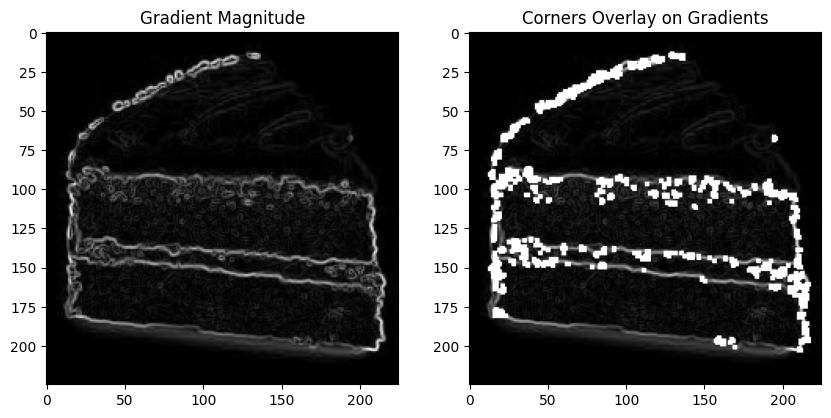

In [107]:
# Detect corners using Harris corner detection
dst = cv2.cornerHarris(np.float32(gray), 2, 3, 0.04)
dst = cv2.dilate(dst, None)

# Threshold to find strong corners
threshold = 0.01 * dst.max()
corners = dst > threshold

# Create a copy of the gradient magnitude to overlay corners
overlay = np.copy(magnitude)
overlay[corners] = 255  # Highlight corners

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Gradient Magnitude")
plt.imshow(magnitude, cmap='gray')
plt.subplot(1, 2, 2)
plt.title("Corners Overlay on Gradients")
plt.imshow(overlay, cmap='gray')
plt.show()

* Explain why the algorithm might struggle
with circular shapes or irregular toppings.

Ans: Circular shapes lack sharp intersections, and irregular toppings only get detected if they have high-contrast edges.

* Replace the pizza with a perfectly square sandwich or a triangle-shaped slice of cake. Compare the results—what kind of food makes Harris the happiest?

Ans: The triangle cake produces less strong corner detections at its three vertices, making pizza a better choice. Its probably because of the quality of the cake image as its edges are extremley similar with the background of the image.


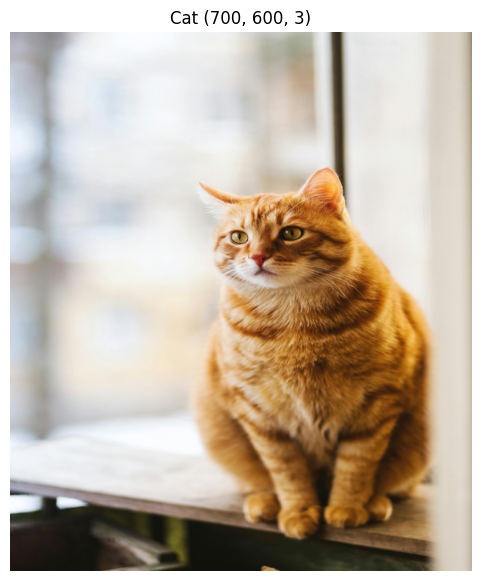

In [108]:
image_path = os.path.join(folder_path, os.listdir(folder_path)[3])
image = cv2.imread(image_path)
image_Copy = np.copy(image)
#new
width = 600
height = 700
dim = (width, height)
resized_image = cv2.resize(image, dim, interpolation = cv2.INTER_AREA)
image_Copy = np.copy(resized_image)
true_cat = cv2.cvtColor(image_Copy, cv2.COLOR_BGR2RGB)
plt.imshow(true_cat)
plt.title('Cat '+f'{true_cat.shape}')
plt.axis('off')
plt.show()

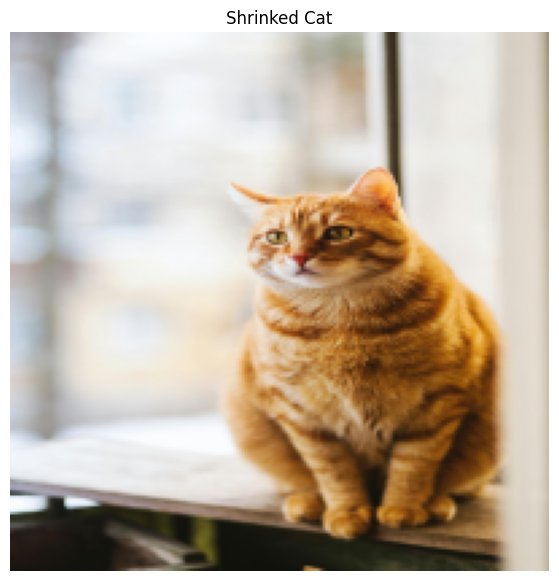

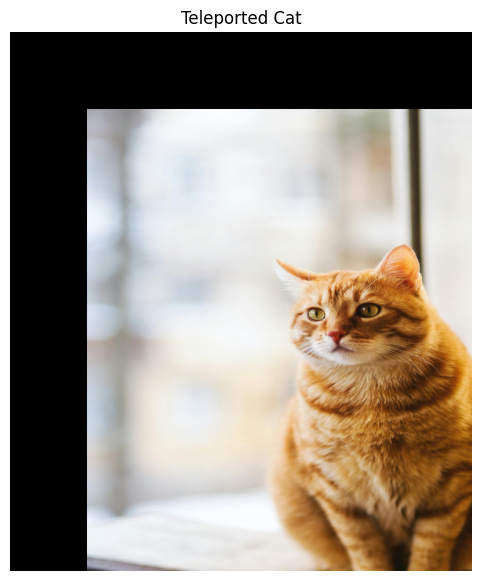

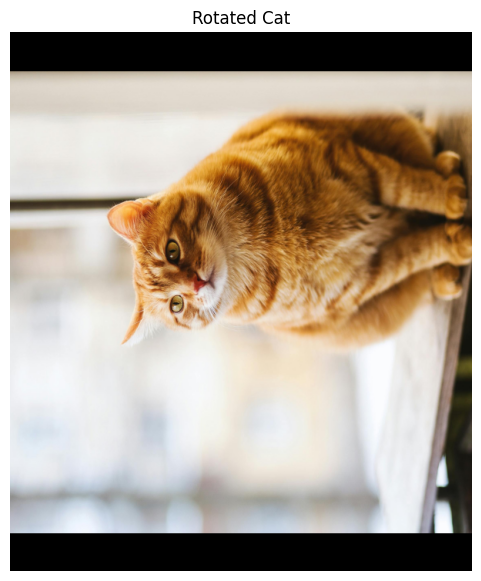

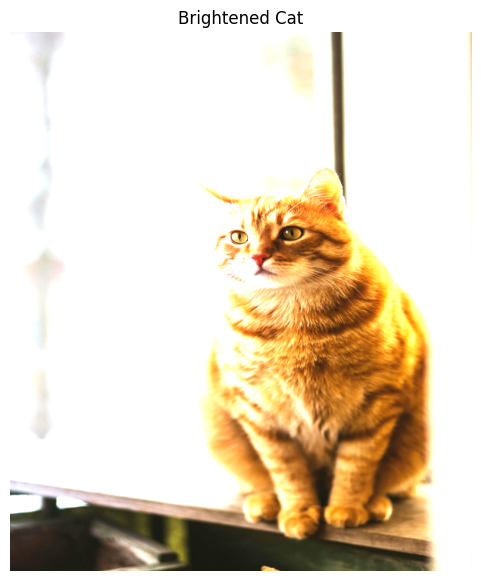

In [59]:
#The Shrinking Spell
width = 200
height = 200
dim = (width, height)
resized_image = cv2.resize(true_cat, dim, interpolation = cv2.INTER_AREA)
plt.imshow(resized_image)
plt.title('Shrinked Cat')
plt.axis('off')
plt.show()

#The Teleportation Act
shift_x = 100  # shift right by 100 pixels
shift_y = 100  # shift down by 100 pixels
# Create the translation matrix
translation_matrix = np.float32([[1, 0, shift_x],
                                  [0, 1, shift_y]])
# Apply the translation
translated_image = cv2.warpAffine(true_cat, translation_matrix, (true_cat.shape[1], true_cat.shape[0]))
plt.imshow(translated_image)
plt.title('Teleported Cat')
plt.axis('off')
plt.show()

#The Twisting Tail Move
rows,cols = true_cat.shape[:2]
R_M = cv2.getRotationMatrix2D((cols/2,rows/2),90, 1)
rotated_image = cv2.warpAffine(true_cat,R_M,(cols,rows))
plt.imshow(rotated_image)
plt.title('Rotated Cat')
plt.axis('off')
plt.show()

#The Sunbeam Glow
factor = 1.5
brightened_image = np.clip(true_cat * factor, 0, 255).astype(np.uint8)
plt.imshow(brightened_image)
plt.title('Brightened Cat')
plt.axis('off')
plt.show()

test_images = [true_cat, resized_image, translated_image, rotated_image, brightened_image]

Number of Keypoints Detected In The Training Image:  618
Number of Keypoints Detected In The Query Image:  241
Number of Keypoints Detected In The Training Image:  618
Number of Keypoints Detected In The Query Image:  527
Number of Keypoints Detected In The Training Image:  618
Number of Keypoints Detected In The Query Image:  590
Number of Keypoints Detected In The Training Image:  618
Number of Keypoints Detected In The Query Image:  805


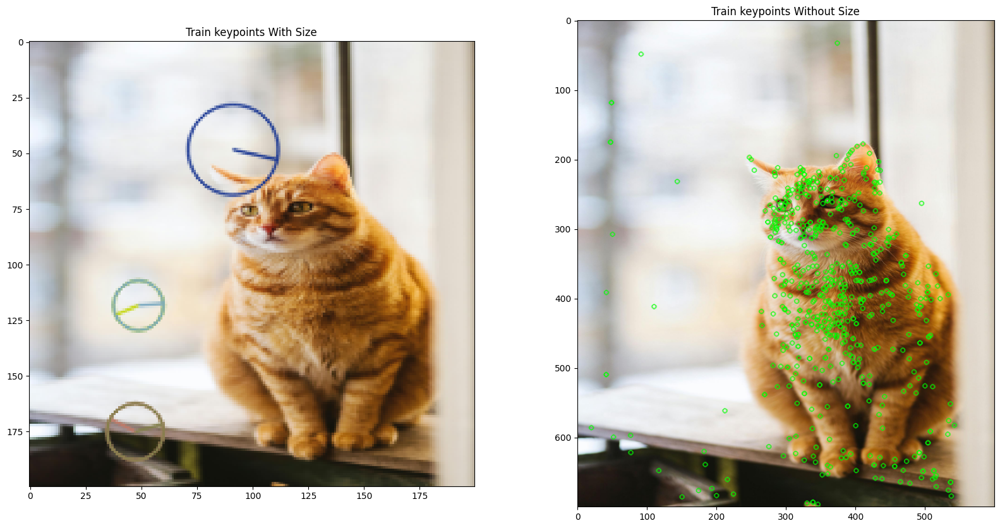

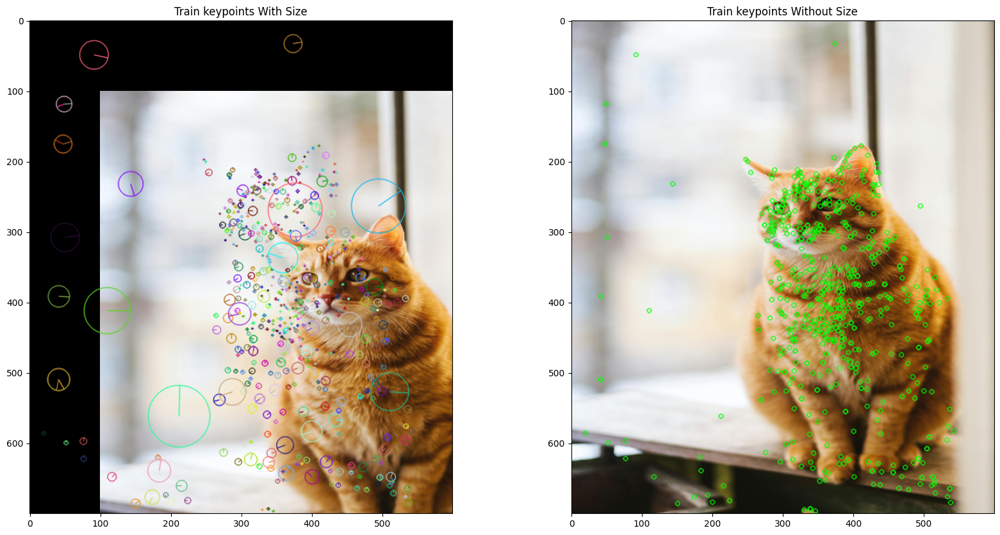

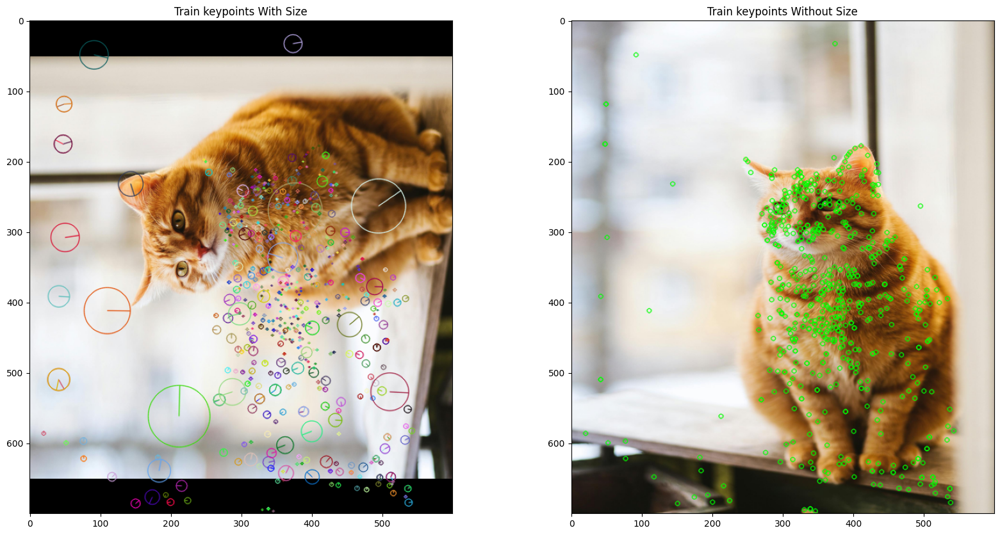

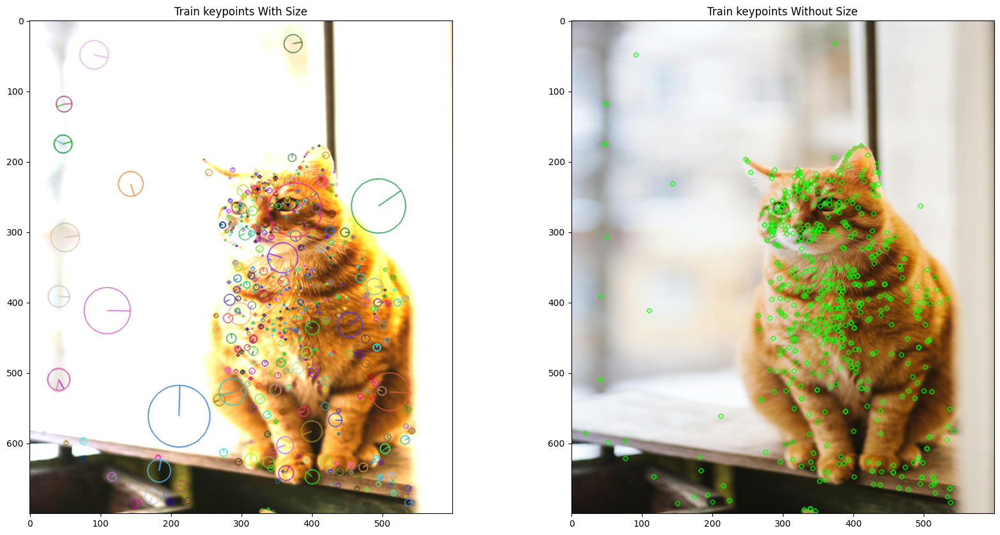

In [60]:
# Detect keypoints and Create Descriptor
def featuring(training_image,test_image):
    # sift = cv2.xfeatures2d.SIFT_create()
    sift = cv2.SIFT_create()

    test_gray = cv2.cvtColor(test_image, cv2.COLOR_RGB2GRAY)
    training_gray = cv2.cvtColor(training_image, cv2.COLOR_RGB2GRAY)

    train_keypoints, train_descriptor = sift.detectAndCompute(training_gray, None)
    test_keypoints, test_descriptor = sift.detectAndCompute(test_gray, None)

    keypoints_without_size = np.copy(training_image)
    keypoints_with_size = np.copy(test_image)

    cv2.drawKeypoints(training_image, train_keypoints, keypoints_without_size, color = (0, 255, 0))

    cv2.drawKeypoints(test_image, train_keypoints, keypoints_with_size, flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

    # Display image with and without keypoints size
    fx, plots = plt.subplots(1, 2, figsize=(20,10))

    plots[0].set_title("Train keypoints With Size")
    plots[0].imshow(keypoints_with_size, cmap='gray')

    plots[1].set_title("Train keypoints Without Size")
    plots[1].imshow(keypoints_without_size, cmap='gray')

    # Print the number of keypoints detected in the training image
    print("Number of Keypoints Detected In The Training Image: ", len(train_keypoints))

    # Print the number of keypoints detected in the query image
    print("Number of Keypoints Detected In The Query Image: ", len(test_keypoints))
for i in range(1,len(test_images)):
    featuring(test_images[0],test_images[i])

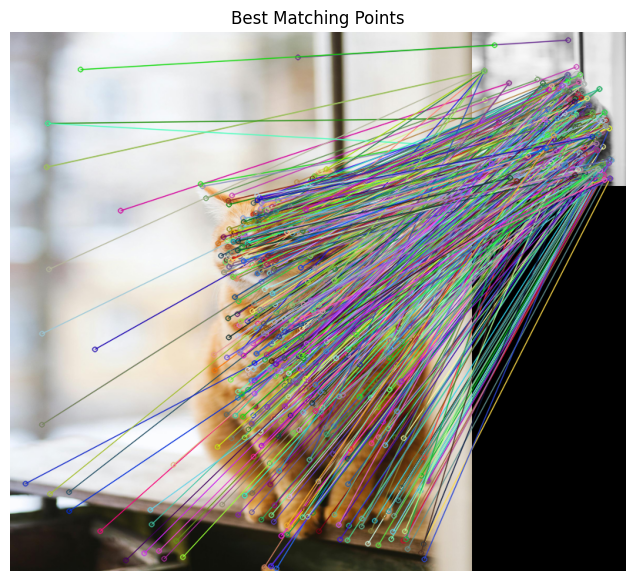


Number of Matching Keypoints Between The Training and Query Images:  618


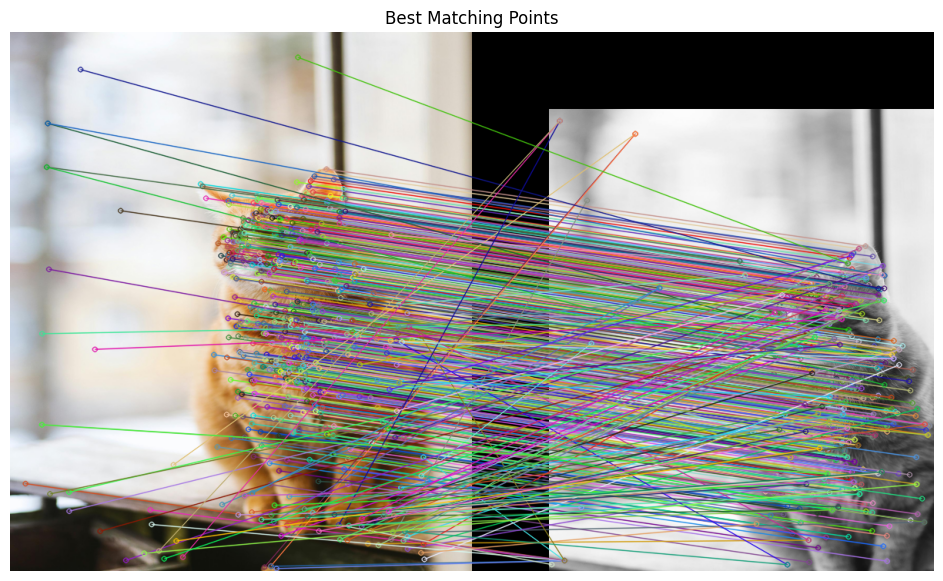


Number of Matching Keypoints Between The Training and Query Images:  618


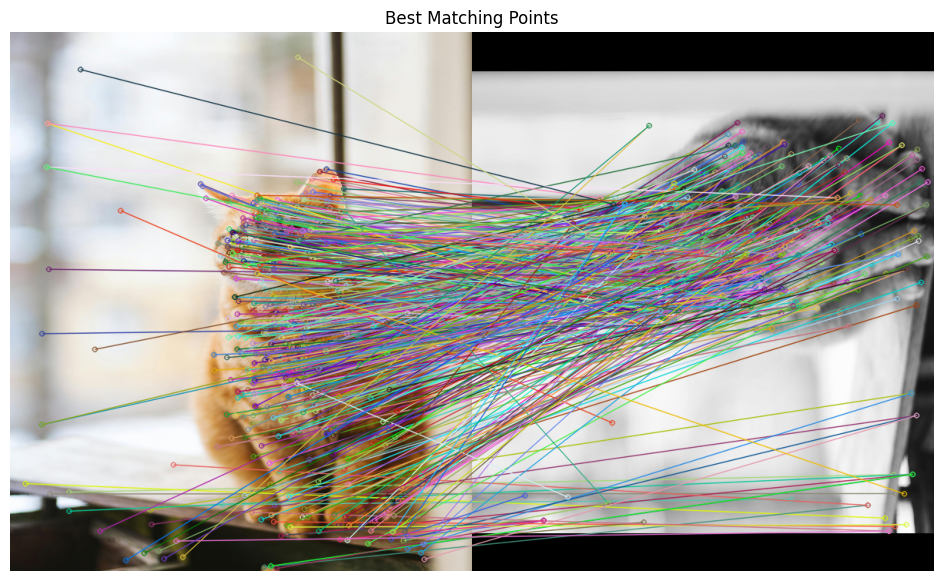


Number of Matching Keypoints Between The Training and Query Images:  618


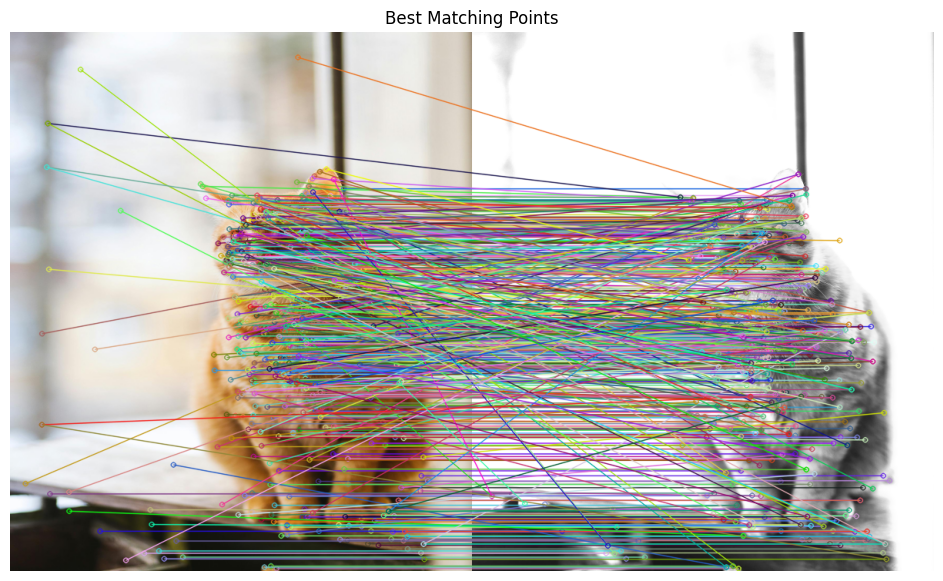


Number of Matching Keypoints Between The Training and Query Images:  618


In [61]:
# Matching Keypoints
def matching_lines(training_image,test_image):
  sift = cv2.SIFT_create()

  test_gray = cv2.cvtColor(test_image, cv2.COLOR_RGB2GRAY)
  training_gray = cv2.cvtColor(training_image, cv2.COLOR_RGB2GRAY)
  train_keypoints, train_descriptor = sift.detectAndCompute(training_gray, None)
  test_keypoints, test_descriptor = sift.detectAndCompute(test_gray, None)

  # Create a Brute Force Matcher object.
  bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck = False)

  # Perform the matching between the SIFT descriptors of the training image and the test image
  matches = bf.match(train_descriptor, test_descriptor)

  # The matches with shorter distance are the ones we want.
  matches = sorted(matches, key = lambda x : x.distance)

  result = cv2.drawMatches(training_image, train_keypoints, test_gray, test_keypoints, matches, test_gray, flags = 2)

  # Display the best matching points
  plt.rcParams['figure.figsize'] = [14.0, 7.0]
  plt.title('Best Matching Points')
  plt.imshow(result)
  plt.axis('off')
  plt.show()
  # Print total number of matching points between the training and query images
  print("\nNumber of Matching Keypoints Between The Training and Query Images: ", len(matches))
for i in range(1,len(test_images)):
    matching_lines(test_images[0],test_images[i])

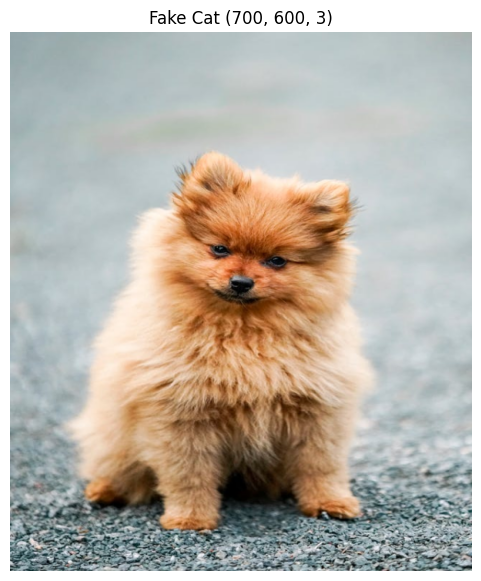

In [62]:
image_path = os.path.join(folder_path, os.listdir(folder_path)[1])
image = cv2.imread(image_path)
image_Copy = np.copy(image)
#new
width = 600
height = 700
dim = (width, height)
resized_image = cv2.resize(image, dim, interpolation = cv2.INTER_AREA)
image_Copy = np.copy(resized_image)
fake_cat = cv2.cvtColor(image_Copy, cv2.COLOR_BGR2RGB)
plt.imshow(fake_cat)
plt.title('Fake Cat '+f'{fake_cat.shape}')
plt.axis('off')
plt.show()

Number of Keypoints Detected In The Training Image:  618
Number of Keypoints Detected In The Query Image:  2482


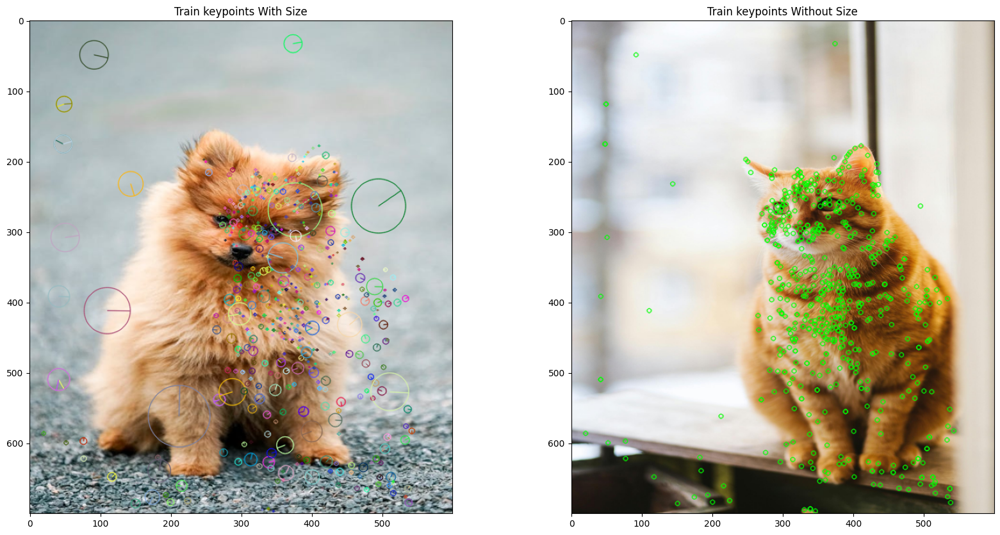

In [63]:
featuring(test_images[0],fake_cat)

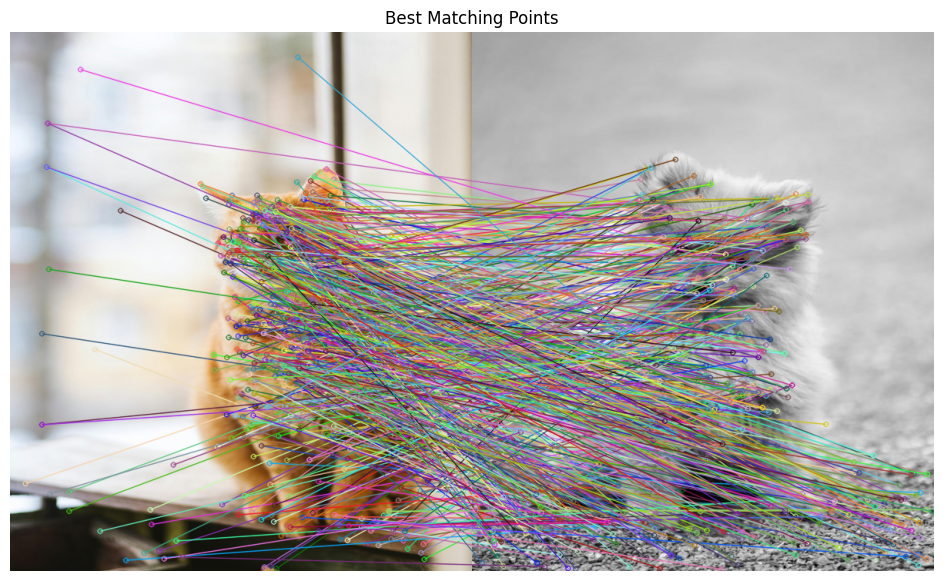


Number of Matching Keypoints Between The Training and Query Images:  618


In [64]:
matching_lines(test_images[0],fake_cat)

Can SIFT Handle the Cat-Dog Disguise?

Ans: Despite being two different cats, SIFT detects 618 matching keypoints due to the similarity in shape, texture, and pose. This high number of matches shows that while SIFT is excellent at finding local visual similarities, it can be mis-led in cases where semantically different objects share similar visual structures. Therefore, SIFT alone cannot reliably distinguish between lookalike objects in this case.

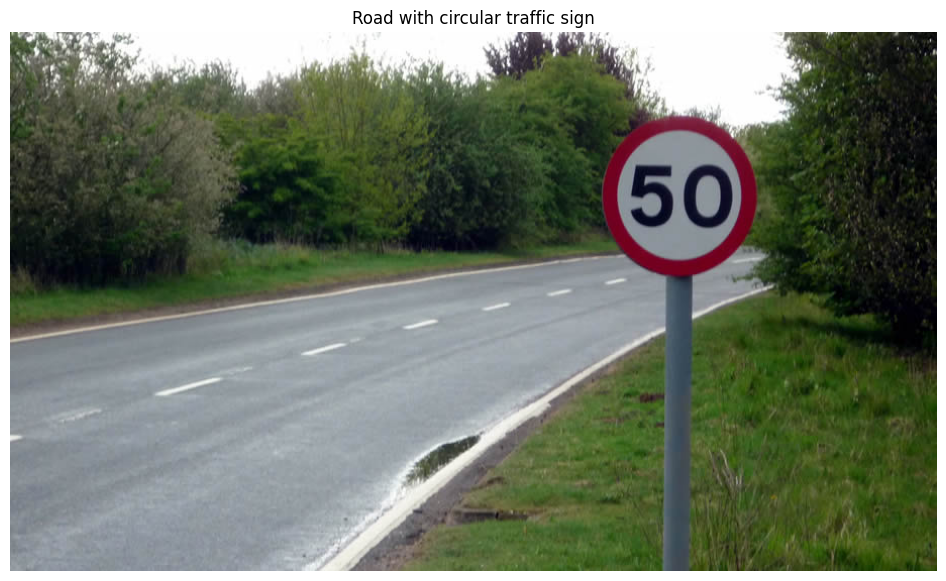

In [65]:
image_path = os.path.join(folder_path, os.listdir(folder_path)[2])
original_image = cv2.imread(image_path, cv2.IMREAD_COLOR_RGB)
image = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
plt.imshow(original_image)
plt.title('Road with circular traffic sign')
plt.axis('off')
plt.show()

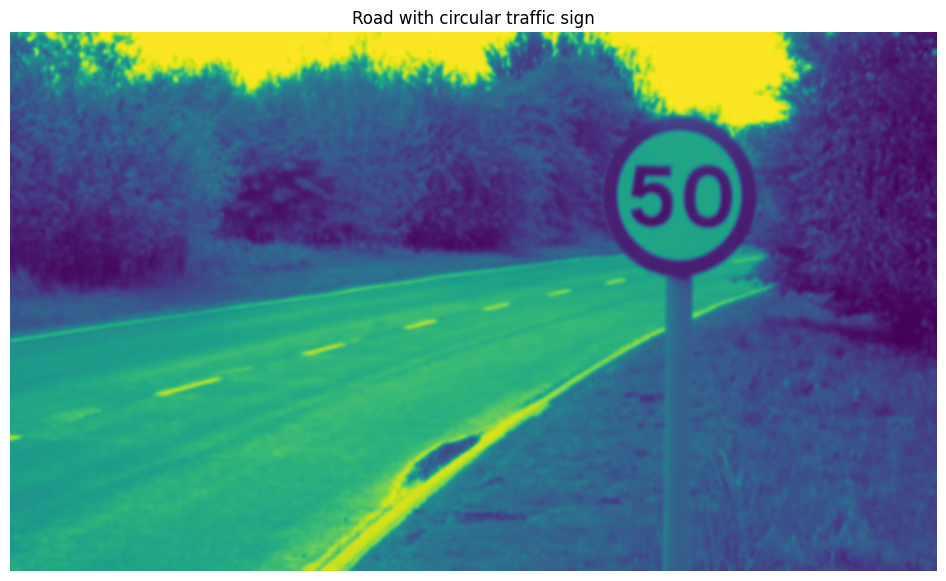

In [66]:
image = cv2.GaussianBlur(image,(7,7),0)
plt.imshow(image)
plt.title('Road with circular traffic sign')
plt.axis('off')
plt.show()

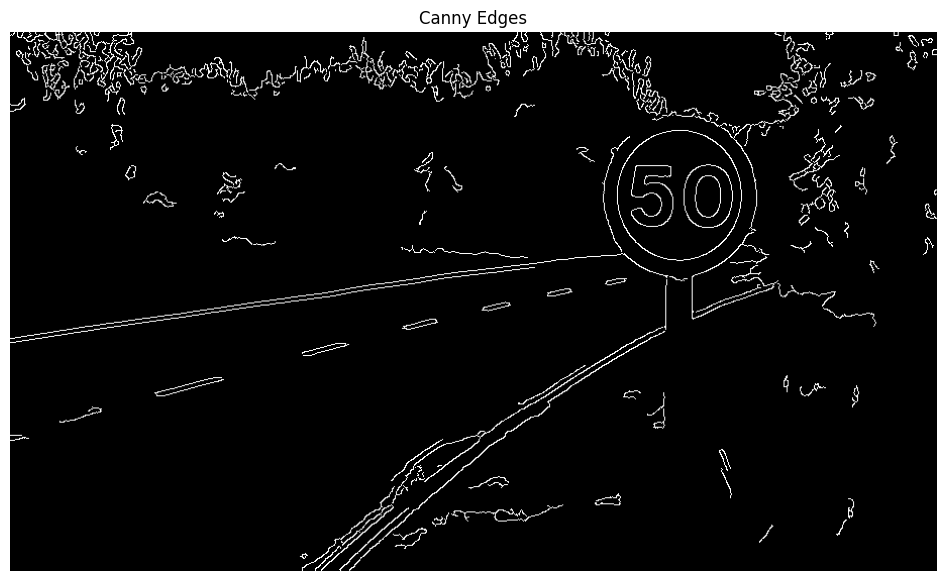

In [76]:
low_threshold = 30
high_threshold = 100
edges = cv2.Canny(image, low_threshold, high_threshold)
plt.imshow(edges, cmap='gray')
plt.title('Canny Edges')
plt.axis('off')
plt.show()

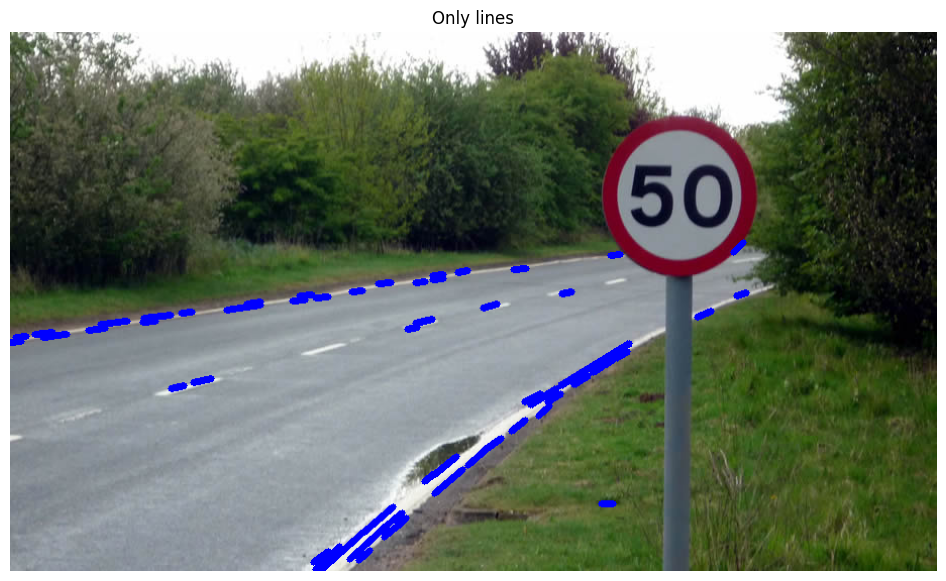

In [121]:
rho = 1
theta = np.pi/240
threshold = 50
min_line_length = 10
max_line_gap = 0.5
line_image = np.copy(original_image) #creating an image copy to draw lines on# Run Hough on the edge-detected image
lines = cv2.HoughLinesP(edges, rho, theta, threshold, np.array([]),
                        min_line_length, max_line_gap)   # Iterate over the output "lines" and draw lines on the image copy

for line in lines:
    for x1,y1,x2,y2 in line:
        cv2.line(line_image,(x1,y1),(x2,y2),(0, 0, 255),5)

plt.imshow(line_image)
plt.title('Only lines')
plt.axis('off')
plt.show()

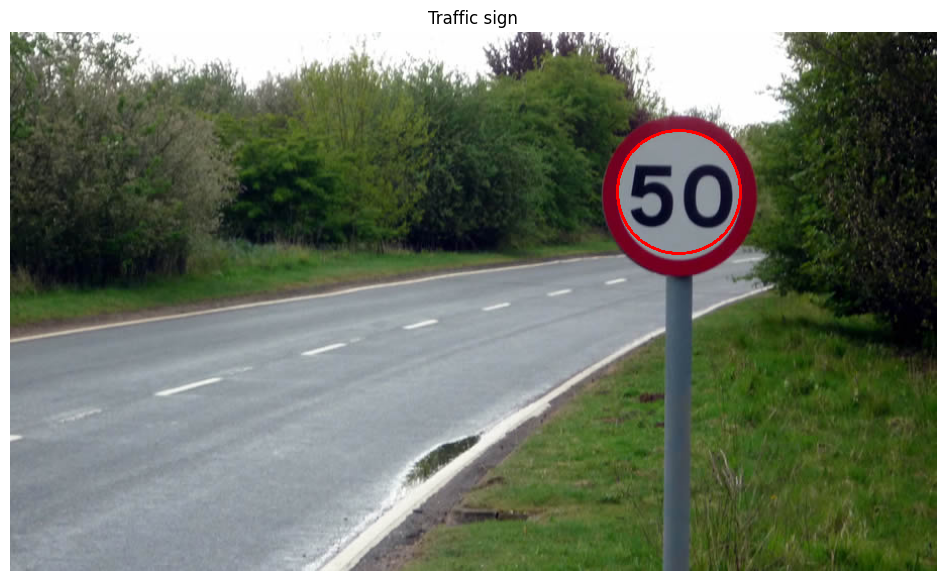

In [115]:
temp = np.copy(original_image)
circles = cv2.HoughCircles(edges,cv2.HOUGH_GRADIENT,.5,20,
                            param1=100,param2=50,minRadius=50,maxRadius=150)

circles = np.uint16(np.around(circles))
for i in circles[0,:]:
    # draw the outer circle
    cv2.circle(temp,(i[0],i[1]),i[2],(255,0,0),2)

plt.imshow(temp)
plt.title('Traffic sign')
plt.axis('off')
plt.show()

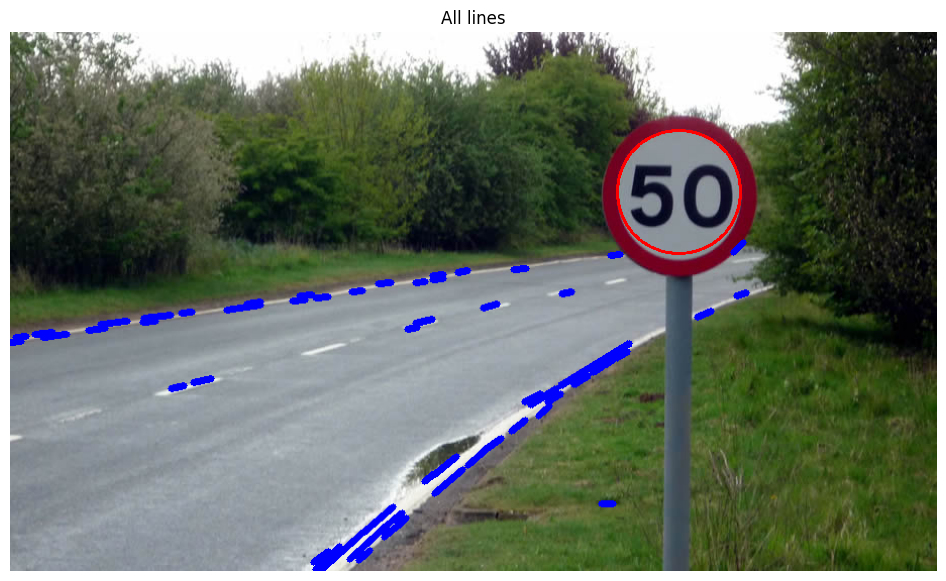

In [122]:
test = np.copy(line_image)
temp = np.copy(edges)
circles = cv2.HoughCircles(edges,cv2.HOUGH_GRADIENT,.5,20,
                            param1=100,param2=50,minRadius=50,maxRadius=150)

circles = np.uint16(np.around(circles))
for i in circles[0,:]:
    # draw the outer circle
    cv2.circle(test,(i[0],i[1]),i[2],(255,0,0),2)

plt.imshow(test)
plt.title('All lines')
plt.axis('off')
plt.show()